# <u>Data Cleaning and Analysis

## Project Background Information.
Every ten years, the United Kingdom undertakes a census of the population, with the most recent one having been conducted in 2021. The purpose of such a census is to compare different people across the nation and to provide the government with accurate statistics of the population to enable better planning, to develop policies, and to allocate certain funding.

__Using a mock census of an imaginary modest town, one should consider themselves to be part of a local government team who will be making decisions on what to do with an unoccupied plot of land and what to invest in. To address these questions, you will need to clean and analyse the mock census data provided.__

### The Tasks.
The town from the census is a modestly sized one sandwiched between two much larger cities that it is connected to by motorways. The town does not have a university, but students do live in the town and commute to the nearby cities. Once you have a cleaned dataset to analyse, your task is to decide the following:
1. __What should be built on an unoccupied plot of land that the local government wishes to develop? Your choices are:__
 1. High-density housing: This should be built if the population is significantly expanding.
 2. Low-density housing: This should be built if the population is “affluent” and there is demand for large family housing.
 3. Train station: There are potentially a lot of commuters in the town and building a train station could take pressure off the roads. But how will you identify commuters?
 4. Religious building: There is already one place of worship for Catholics in the town. Is there demand for a second Church (if so, which denomination?), or for a different religious building?
 5. Emergency medical building: Not a full hospital, but a minor injuries centre. This should be built if there are many injuries or future pregnancies likely in the population.
 6. Something else? Whichever you choose, you must justify it from the data provided to you and argue it is a priority against other choices.


2. __Which one of the following options should be invested in:__
 1. Employment and training: If there is evidence for a lot of unemployment, we should retrain people for new skills
 2. Old age care. If there is evidence for increasing numbers of retired people in future years, the town will need to allocate more funding for end of life care
 3. Increase spending for schooling. If there is evidence of a growing population of schoolaged children (new births, or families moving in to the town), then schooling spend should increase
 4. General infrastructure. If the town is expanding, then services (waste collection; road maintenance, etc.) will require more investment

### Importing the relevant libraries

In [2]:
#Importing relevant libraries for the tasks
import csv                       
import pandas as pd   
import seaborn as sns 
import numpy as np    
import pprint
from pandas_profiling import ProfileReport
import matplotlib as matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.ticker as ticker
import matplotlib.cm as cm
from matplotlib.gridspec import GridSpec
import missingno as msno

### <u> Breakdown of steps to be undertaken
1. __Data cleaning__
2. __Data exploration and statistical analysis__

## Section 1: Data Cleaning
__The next few steps will involve reading in the csv file and using profile report to get a quick understanding of the dataset__

### A: Exploring the data to understand the cleaning that is required.

In [3]:
#CSV_01_2022 data is the relevant dataset
census_1881 = pd.read_csv('./census_01_2022.csv')
census_1881.head(5)

,Unnamed: 0,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion
0,0,1,Albert Inlet,Lynda,Burke,38,Head,Single,Female,Mechanical engineer,None,Catholic
1,1,1,Albert Inlet,Jane,Burke,1,Daughter,NaN,Female,Child,None,NaN
2,2,1,Albert Inlet,Gerard,Roberts,31,Lodger,Divorced,Male,Training and development officer,None,Christian
3,3,2,Albert Inlet,Trevor,Newman,59,Head,Single,Male,Arts administrator,None,None
4,4,3,Albert Inlet,Guy,Armstrong,74,Head,Divorced,Male,Retired Patent attorney,None,None


In [4]:
#checking the columns in the df
census_1881.columns

Index(['Unnamed: 0', 'House Number', 'Street', 'First Name', 'Surname', 'Age',
       'Relationship to Head of House', 'Marital Status', 'Gender',
       'Occupation', 'Infirmity', 'Religion'],
      dtype='object')

In [5]:
#Removing the unnamed column which is the same as the index column
census_1881 = census_1881[['House Number', 'Street', 'First Name', 'Surname', 'Age',
                           'Relationship to Head of House', 'Marital Status', 'Gender',
                           'Occupation', 'Infirmity', 'Religion']]

In [6]:
#resetting the index
census_1881.head(5)

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion
0,1,Albert Inlet,Lynda,Burke,38,Head,Single,Female,Mechanical engineer,None,Catholic
1,1,Albert Inlet,Jane,Burke,1,Daughter,NaN,Female,Child,None,NaN
2,1,Albert Inlet,Gerard,Roberts,31,Lodger,Divorced,Male,Training and development officer,None,Christian
3,2,Albert Inlet,Trevor,Newman,59,Head,Single,Male,Arts administrator,None,None
4,3,Albert Inlet,Guy,Armstrong,74,Head,Divorced,Male,Retired Patent attorney,None,None


In [7]:
#using the info() method to get a quick glance on the data
census_1881.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9387 entries, 0 to 9386
Data columns (total 11 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   House Number                   9387 non-null   int64 
 1   Street                         9387 non-null   object
 2   First Name                     9387 non-null   object
 3   Surname                        9387 non-null   object
 4   Age                            9387 non-null   object
 5   Relationship to Head of House  9387 non-null   object
 6   Marital Status                 7165 non-null   object
 7   Gender                         9387 non-null   object
 8   Occupation                     9387 non-null   object
 9   Infirmity                      9387 non-null   object
 10  Religion                       7112 non-null   object
dtypes: int64(1), object(10)
memory usage: 806.8+ KB


In [8]:
#using the isnull() method to check for null values
census_1881.isnull().sum()

House Number                        0
Street                              0
First Name                          0
Surname                             0
Age                                 0
Relationship to Head of House       0
Marital Status                   2222
Gender                              0
Occupation                          0
Infirmity                           0
Religion                         2275
dtype: int64

In [ ]:
#https://towardsdatascience.com/visualizing-missing-values-in-python-is-shockingly-easy-56ed5bc2e7ea
msno.bar(census_1881)
plt.show()

In [ ]:
msno.matrix(census_1881)
plt.show()

In [11]:
#using the describe() method to check the general shape of the data
census_1881.describe(include=object)

,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion
count,9387,9387,9387,9387,9387,7165,9387,9387,9387,7112
unique,104,365,691,109,22,9,9,1104,7,13
top,Murphy River,Jennifer,Smith,38,Head,Single,Male,Student,None,None
freq,764,41,253,184,3360,3269,4399,1831,9317,3185


In [12]:
#using the describe() method without object to check the general shape of the data
census_1881.describe()

,House Number
count,9387.000000
mean,52.838074
std,57.204688
min,1.000000
25%,10.000000
50%,28.000000
75%,82.000000
max,232.000000


In [13]:
#using profile report to get another close look at the data
profile_report = ProfileReport(census_1881)
profile_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### B: Exploring each of the columns to address possible errors
### Emphasis is on exploring each of the columns separately


### B(i): House Number
__Dealing with the House Number Column__

In [14]:
#Defining a function to check unique values in each column
#The function takes 2 arguments: the df name and the column
def check_unique(df,column_name):
    check_unique = df[column_name].unique()
    
    return check_unique

In [15]:
#checking for unique values in the House Number column
check_unique(census_1881,'House Number')

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
       131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
       144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
       157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169,
       170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 18

In [16]:
#checking for blank values
census_1881.loc[(census_1881['House Number'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion


__There are no nan values in the House Number column and the datatype is integers which is the appropriate type.__

### B(ii): Street
__Dealing with the Street Column__

In [17]:
#checking for unique values in the Street column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Street')

array(['Albert Inlet', 'Magicianplace Lane', 'September Neck',
       'Berry Tunnel', 'Daisy Valleys', 'Holly Forge',
       'CherryChestnut Lane', 'Ranger Extension', 'Cannon Road',
       'Ely Green', 'Anglia Overpass', 'Ambrosia Bypass', 'Preston Road',
       'Wessex Lane', 'Manor Avenue', 'Fry Extensions', 'Bevan Gardens',
       'Duffy Lane', 'Grapevat Avenue', 'Collins Lane', 'Shrine Trail',
       'Victoria Valley', 'Charity Plains', 'Greencharm Street',
       'Iqbal Drive', 'Albion Drive', 'Jones Harbor', 'Parrot Road',
       'Dragons Mountain', 'Payne Hill', 'December Path',
       'Douglas Street', 'Mainlake Road', 'Hereford Brooks',
       'Lancelotthwaite Drive', 'Minster Lane', 'St.Matthew Falls',
       'Gallows Lakes', 'Church Lane', 'Christmas Road', 'Arch Drive',
       'Fox Drive', 'Bruce Mountain', 'Burgess Wall', 'Music Brook',
       'Truro Street', 'Mill Ports', 'Turner Stream', 'Oak Drive',
       'Harrison Circles', 'Moss Gateway', 'Chemist Run', 'Knight Glen

In [18]:
#checking for blank values
census_1881.loc[(census_1881['Street'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion


__There are no nan values in the Street column and so far, no obvious errors.__

### B(iii): First Name
__Dealing with the First Name Column__

In [19]:
#checking for unique values in the First Name column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'First Name')

array(['Lynda', 'Jane', 'Gerard', 'Trevor', 'Guy', 'Carol', 'Beth',
       'Vincent', 'Lawrence', 'Arthur', 'Roger', 'Diane', 'Leonard',
       'Leslie', 'Bethan', 'Ronald', 'Alice', 'Adrian', 'Janet',
       'Charlene', 'Natalie', 'Stuart', 'Patricia', 'Kimberley',
       'Douglas', 'Darren', 'Denise', 'Carole', 'Robin', 'Gail',
       'Christian', 'Ian', 'Rachel', 'Nicholas', 'Norman', 'Natasha',
       'Barry', 'Hollie', 'Leon', 'Charlie', 'Anne', 'Valerie', 'Roy',
       'Colin', 'Gerald', 'Melanie', 'Wayne', 'Amber', 'Luke', 'Gareth',
       'Abdul', 'Lynn', 'Kenneth', 'Josephine', 'Terence', 'Hugh',
       'Sandra', 'Raymond', 'Phillip', 'Kieran', 'Rosemary', 'Hannah',
       'William', 'Stacey', 'Danielle', 'Marian', 'Georgina', 'Catherine',
       'Molly', 'Patrick', 'Gary', 'Sian', 'Jennifer', 'Alan', 'Ashleigh',
       'Laura', 'Kyle', 'Billy', 'Kathleen', 'Carl', 'Samuel', 'Chelsea',
       'Damien', 'Martyn', 'Kerry', 'Suzanne', 'Sean', 'Sarah', 'Gordon',
       'Joanne', '

In [20]:
#checking for blank values
census_1881.loc[(census_1881['First Name'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion
5160,28,Chemist Run,,Metcalfe,10,Son,NaN,Male,Student,None,NaN


__There is a person with a blank first name and this will need to be addressed.__

In [21]:
#function to check the houshold dynamics based on the street and house number
def check_hh(df,house_number,street,i,j):
    check_hh = df.loc[(df[house_number] == i) & (df[street] == j)]
    
    return check_hh

In [22]:
#checking the household of the person with the missing first name
check_hh(census_1881,'House Number','Street',28,'Chemist Run')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion
5159,28,Chemist Run,Louise,Metcalfe,27,Head,Single,Female,Unemployed,None,Methodist
5160,28,Chemist Run,,Metcalfe,10,Son,NaN,Male,Student,None,NaN
5161,28,Chemist Run,Kim,Metcalfe,7,Daughter,NaN,Female,Student,None,NaN
5162,28,Chemist Run,Holly,Metcalfe,0,Daughter,NaN,Female,Child,None,NaN
5163,28,Chemist Run,Graham,Davison,62,Lodger,Single,Male,Unemployed,None,Christian


__The missing first name will be fixed using the most common first name in the town for kids age 9-14.__
<br>__This is because from the names in the household, it is not clear what the name should be.__
<br>__If there had been a father in the household, a good guess might have been adding the suffix jr at the end of the father's name.__

In [23]:
#doing a count of the most common first names in the town
first_name_9_14 = census_1881[(census_1881['Age'].isin(['9','10','11','12','13','14'])) & (census_1881['Gender'].isin(['Male','M'])) & (census_1881['First Name'])]
first_name_9_14['First Name'].value_counts()

David        7
Frank        7
Brett        7
Damian       6
Joel         6
            ..
Stewart      1
Wayne        1
Frederick    1
Matthew      1
Luke         1
Name: First Name, Length: 172, dtype: int64

__The names David, Frank and Brett are the most common first names. The blank data will be replaced with the name David.__

In [24]:
#replacing the blank first name
census_1881['First Name'] = census_1881['First Name'].replace(' ', 'David')

In [25]:
#checking the household of the person with the missing first name again
check_hh(census_1881,'House Number','Street',28,'Chemist Run')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion
5159,28,Chemist Run,Louise,Metcalfe,27,Head,Single,Female,Unemployed,None,Methodist
5160,28,Chemist Run,David,Metcalfe,10,Son,NaN,Male,Student,None,NaN
5161,28,Chemist Run,Kim,Metcalfe,7,Daughter,NaN,Female,Student,None,NaN
5162,28,Chemist Run,Holly,Metcalfe,0,Daughter,NaN,Female,Child,None,NaN
5163,28,Chemist Run,Graham,Davison,62,Lodger,Single,Male,Unemployed,None,Christian


__There are no nan values in the First Name column and no other errors.__

### B(iv): Surname
__Dealing with the Surname Column__

In [26]:
#checking for unique values in the Surname column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Surname')

array(['Burke', 'Roberts', 'Newman', 'Armstrong', 'Jackson', 'Watson',
       'Wood', 'Mistry', 'Hilton', 'Goddard', 'Johnson', 'Dawson',
       'Baker', 'Patel', 'Sheppard', 'Cox', 'Davis', 'Simpson', 'Stevens',
       'Allen', 'Williams-Allen', 'Bryant', 'Jones', 'Cooper', 'Reynolds',
       'Chan', 'Ingram', 'Murray', 'Lewis', 'Collins', 'Gill', 'Slater',
       'Clark', 'Harris-Cooper', 'Schofield', 'Kelly', 'Green', 'Abbott',
       'Miah', 'Gray', 'Bond', 'White', 'Thomas', 'Barnett', 'Brown',
       'Williams', 'Hooper', 'Cooke', 'Woodward', 'Davison', 'Campbell',
       'Clark-Barry', 'Walker', 'Edwards', 'Kemp', 'Hudson', 'Warner',
       'Harper', 'Hurst', 'Wilkinson', 'Knowles-Woodward', 'Lambert',
       'Miller', 'Jenkins', 'Bibi', 'Wood-Mills', 'Taylor', 'Powell',
       'Martin', 'Wood-Jones', 'Bruce', 'Hunt', 'Walsh-Parkinson', 'Ward',
       'Khan', 'Little', 'Simmons', 'Chadwick', 'Smith', 'Norman',
       'Farrell', 'Kay', 'Porter', 'Wells', 'Wilson', 'Baldwin', 'New

In [27]:
#checking for blank values
census_1881.loc[(census_1881['Surname'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion


__There are no nan values in the Surname column and so far, no obvious errors.__

### B(v): Age
__Dealing with the Age Column__

In [28]:
#checking the unique values in the Age column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Age')

array(['38', '1', '31', '59', '74', '98', '51', '37', '36', '79', '33',
       '10', '39', '40', '3', '76', '58', '55', '21', '17', '14', '71',
       '35', '5', '4', '2', '16', '73', '27', '44', '0', '49', '25', '48',
       '50', '9', '61', '63', '18', '19', '64', '67', '53', '15', '30',
       '12', '45', '11', '32', '7', '56', '78', '43', '26', '47', '70',
       '34', '75', '77', '46', '13', '54', '81', '85', '28', '69', '41',
       '57', '22', '29', '20', '65', '72', '60', '68', '84', '6', '62',
       '23', '52', '42', '8', '24', '88', '97', '82', '83', '66', '80',
       '86', '89', '87', '105', '90', '102', '104', '95', '100', '93',
       '94', '91', '99', '96', '106', 'one', '57.7720148', '59.7720148',
       '56.90834691', '51.90834691'], dtype=object)

__The following are some of the points observed from the unique values above:__
1. The age column is in the wrong datatype and this is because there is a string value one in the column
2. Other than the string value contained in the colummn, there are float values in the column

__Ideally, the age column should be in the integer type and adjustments will be made to correct the errors. Corrections to be made include:__
- Changing the word one to numerical 1
- Changing the column to the integer datatype

In [29]:
#replacing the letter one with the numerical 1
census_1881['Age'] = census_1881['Age'].replace('one', '1')

In [30]:
#converting the Age column first to float and then int
#Converting to float first to prevent an error
census_1881['Age'] = census_1881['Age'].astype(float)
census_1881['Age'] = census_1881['Age'].astype(int)

In [31]:
#checking the new unique values for errors and sorting them
np.sort(check_unique(census_1881,'Age'))

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  93,  94,  95,  96,  97,  98,  99, 100, 102, 104, 105, 106])

__Given that this is age data, one last thing to do, which will be useful for other analysis is grouping the data into age_groups. This will be done next.__

In [32]:
#adding a new column to the dataframe showing age range - a derivative of the age column
census_1881['Age_range'] = pd.cut(x=census_1881['Age'], bins=[-1,4,9,14,19,24,29,34,39,44,49,54,59,64,69,74,79,84,89,94,99,110], labels=['0-4','5-9','10-14','15-19','20-24','25-29','30-34','35-39','40-44','45-49','50-54','55-59','60-64','65-69','70-74','75-79','80-84','85-89','90-94','95-99','100+'])
census_1881.head(10) #checking to show that the new column has been added

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
0,1,Albert Inlet,Lynda,Burke,38,Head,Single,Female,Mechanical engineer,None,Catholic,35-39
1,1,Albert Inlet,Jane,Burke,1,Daughter,NaN,Female,Child,None,NaN,0-4
2,1,Albert Inlet,Gerard,Roberts,31,Lodger,Divorced,Male,Training and development officer,None,Christian,30-34
3,2,Albert Inlet,Trevor,Newman,59,Head,Single,Male,Arts administrator,None,None,55-59
4,3,Albert Inlet,Guy,Armstrong,74,Head,Divorced,Male,Retired Patent attorney,None,None,70-74
5,4,Albert Inlet,Carol,Jackson,98,Head,Widowed,Female,Retired Aeronautical engineer,None,None,95-99
6,5,Albert Inlet,Beth,Watson,51,Head,Married,Female,"Nurse, children's",None,Christian,50-54
7,5,Albert Inlet,Vincent,Watson,59,Husband,Married,Male,Structural engineer,Deaf,None,55-59
8,5,Albert Inlet,Lawrence,Watson,37,Son,Single,Male,"Editor, commissioning",None,Christian,35-39
9,5,Albert Inlet,Arthur,Watson,36,Son,Divorced,Male,Automotive engineer,None,Christian,35-39


In [33]:
#checking for blank values
census_1881.loc[(census_1881['Age'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range


__A new column named Age_range has been added to the dataframe.__
<br>__The Age column looks good now - with errors having been handled.__

### B(vi): Relationship to Head of House
__Dealing with the Relationship to Head of House Column__

In [34]:
#checking the unique values in the Relationship to Head of House column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Relationship to Head of House')

array(['Head', 'Daughter', 'Lodger', 'Husband', 'Son', 'Wife', 'Partner',
       'Step-Daughter', 'Adopted Daughter', 'None', 'Cousin',
       'Adopted Son', 'Granddaughter', 'Sibling', 'Step-Son', 'Neice',
       'Nephew', 'Grandson', 'Visitor', ' ', 'Adopted Grandson',
       'Son-in-law'], dtype=object)

__From the above, a couple of things are obvious:__
<br>- There are rows in the column with blank data (represented with ' '), this is not nan
<br>- There are rows where the values are None (not nan). Checks will be done so see what this means

__This will be addressed over the next few cells.__

In [35]:
#checks for where the data is blank
census_1881.loc[(census_1881['Relationship to Head of House'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3066,39,Arch Drive,Clifford,Harvey,40,,Single,Male,Barrister,None,None,40-44


In [36]:
#using the check_hh function to understand the household
#variables are df, house number column, street column, house number, street name
check_hh(census_1881,'House Number','Street',39,'Arch Drive')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3066,39,Arch Drive,Clifford,Harvey,40,,Single,Male,Barrister,None,None,40-44
3067,39,Arch Drive,Ruth,Carr,37,Partner,Single,Female,Therapeutic radiographer,None,None,35-39


__From the above, in the household, there are 2 people living in the house, one of which is a partner.
<br>From this, we can conclude the missing data is for Head of the House, as this is required for all households.__

In [37]:
#replacing the blank data (' ') with Head
census_1881['Relationship to Head of House'] = census_1881['Relationship to Head of House'].replace(' ', 'Head')

In [38]:
#checks to see if the change using the replace method has been effected
check_hh(census_1881,'House Number','Street',39,'Arch Drive')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3066,39,Arch Drive,Clifford,Harvey,40,Head,Single,Male,Barrister,None,None,40-44
3067,39,Arch Drive,Ruth,Carr,37,Partner,Single,Female,Therapeutic radiographer,None,None,35-39


__The blank data has been addressed, next is the None values.__
<br>__Based on the data, deductions have been made regarding the difference between Lodgers and None, and they are:__
<br> - Lodger category has been used for people with short stays, similar to hotels and Bed & Breakfast
<br> - None category has been used for people who are possibly tenants and therefore have no relationship with the Head
<br> - Therefore, no changes will be done to the category None

__Next is going to be checking for the age of people who are head of house to make sure there are no minors who are head of house__
<br>__Based on the above, where there are people aged less than 18 being Head of house, more checks will be done to understand this__
<br> This is because of __[UK law](https://www.nspcc.org.uk/keeping-children-safe/in-the-home/moving-out/)__ which only allows people aged 16 and above to be able to live alone. Therefore, in some cases it might be possible to have people aged 16 (below 18) be Head of house, however, anything below this will most likely be wrong.

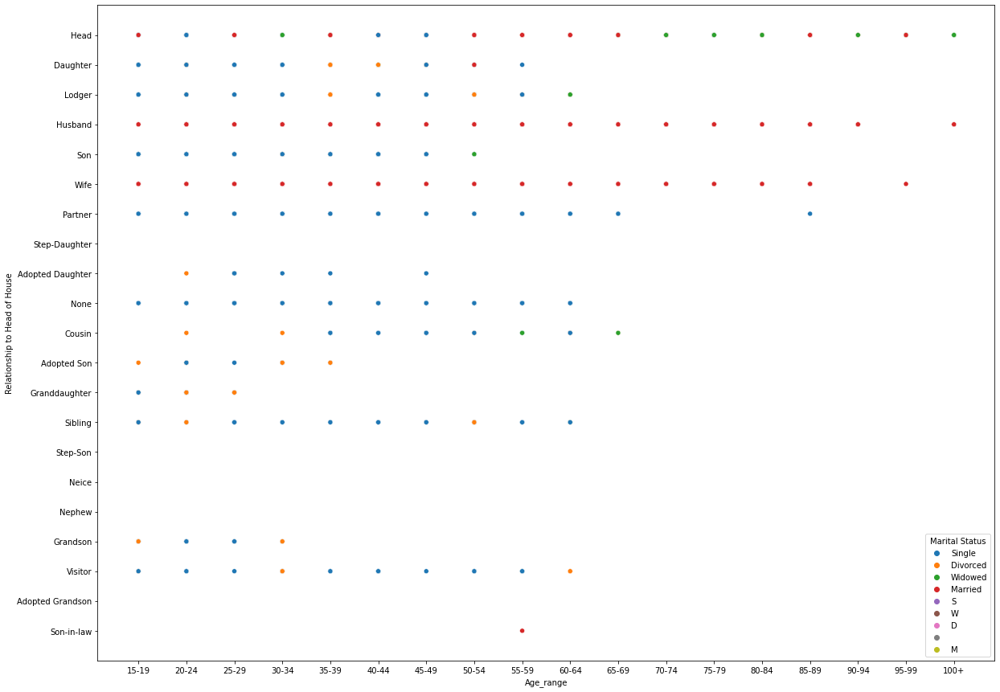

In [39]:
plt.figure(figsize=(20,15))
chart_2 = sns.scatterplot(data=census_1881, y = 'Relationship to Head of House', x = 'Age_range', hue = 'Marital Status')
plt.show()

__Quick check for where people below age 18 are head of house__

In [40]:
census_1881.loc[(census_1881['Age'] < 18) & (census_1881['Relationship to Head of House'] == 'Head')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1117,54,Shrine Trail,Hollie,Heath,15,Head,Single,Female,Student,None,NaN,15-19
3406,74,Bruce Mountain,Eileen,Burgess,16,Head,Single,F,Student,None,NaN,15-19
7526,148,Lavendar Lane,Zoe,Roberts,17,Head,Married,Female,Student,None,NaN,15-19
8885,46,Taylor Lane,Beth,Lamb,17,Head,Single,Female,Student,None,NaN,15-19


__From the above, it is most likely that there are errors in this column. This will be investigated next by checking each of the households involved__

In [41]:
#checking the first household (row 1117)
#using the check_hh function
check_hh(census_1881,'House Number','Street',54,'Shrine Trail')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1117,54,Shrine Trail,Hollie,Heath,15,Head,Single,Female,Student,None,NaN,15-19
1118,54,Shrine Trail,Chloe,Heath,0,Daughter,NaN,Female,Child,Physical Disability,NaN,0-4
1119,54,Shrine Trail,Joanne,Ball,55,Lodger,Single,Female,Merchant navy officer,None,Christian,55-59


__The first case is a tricky one. The data shows a mother and her child as main occupants of a house, however, the mother is aged 15 years old, with the baby being a newborn at age 0.__
<br>- It is possible that the mother was pregnant and homeless and the council has decided to provide emergency accomodation in this situation (__[Shelter](https://england.shelter.org.uk/housing_advice/homelessness/emergency_housing_from_the_council)__)
<br>- The above point is plausbible and therefore, the data will not be changed

In [42]:
#checking the first household (row 3406)
#using the check_hh function
check_hh(census_1881,'House Number','Street',74,'Bruce Mountain')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3406,74,Bruce Mountain,Eileen,Burgess,16,Head,Single,F,Student,None,NaN,15-19
3407,74,Bruce Mountain,Alan,Kaur,24,Partner,,Male,Chemical engineer,None,None,20-24
3408,74,Bruce Mountain,Lawrence,Burgess,0,Son,NaN,Male,Child,None,NaN,0-4
3409,74,Bruce Mountain,Rachael,Bennett,49,Lodger,Single,Female,Event organiser,None,None,45-49


__The second case is similar to the first. A young mother as head of house. The same assumption has been made for this case (also, it is possible that the husband owns the house and the wife has filled the census form given that she was home at the time it was filled) and therefore, the data will not be changed.__

In [43]:
#checking the first household (row 7526)
#using the check_hh function
check_hh(census_1881,'House Number','Street',148,'Lavendar Lane')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
7526,148,Lavendar Lane,Zoe,Roberts,17,Head,Married,Female,Student,None,NaN,15-19
7527,148,Lavendar Lane,Darren,Roberts,23,Husband,Married,Male,"Engineer, structural",None,None,20-24
7528,148,Lavendar Lane,David,Roberts,0,Son,NaN,Male,Child,None,NaN,0-4
7529,148,Lavendar Lane,Conor,Dodd,39,Lodger,Single,Male,Multimedia programmer,None,Christian,35-39


__The third case is similar to the first two cases - going with the the assumption of young mothers who potentially got emergency accomodation from the council. Therefore, the data will not be changed.__

In [44]:
#checking the first household (row 8885)
#using the check_hh function
check_hh(census_1881,'House Number','Street',46,'Taylor Lane')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
8885,46,Taylor Lane,Beth,Lamb,17,Head,Single,Female,Student,None,NaN,15-19
8886,46,Taylor Lane,Stacey,Morris,49,Lodger,Divorced,Female,"Scientist, biomedical",None,None,45-49
8887,46,Taylor Lane,Elizabeth,Parsons,54,Lodger,Single,Female,Sub,None,Christian,50-54
8888,46,Taylor Lane,Ian,Parkes,28,Lodger,Divorced,Male,Computer games developer,None,None,25-29


__The fourth case is different from the three other cases - not a young mother. However, a case can be made relating to emergency council accomodation. Therefore, the data will not be changed.__

__Final unique check for the column__

In [45]:
check_unique(census_1881,'Relationship to Head of House')

array(['Head', 'Daughter', 'Lodger', 'Husband', 'Son', 'Wife', 'Partner',
       'Step-Daughter', 'Adopted Daughter', 'None', 'Cousin',
       'Adopted Son', 'Granddaughter', 'Sibling', 'Step-Son', 'Neice',
       'Nephew', 'Grandson', 'Visitor', 'Adopted Grandson', 'Son-in-law'],
      dtype=object)

### B(vii): Marital Status
__Dealing with the Marital Status Column__

In [46]:
#checking the unique values in the marital status column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Marital Status')

array(['Single', nan, 'Divorced', 'Widowed', 'Married', 'S', 'W', 'D',
       ' ', 'M'], dtype=object)

__The unique values shown above include alphabets instead of words in some places, nan values and blank values.
In these cases, the following will be carried out:__
- Assumptions will be made relating to the fact that S,W,D,M mean Single, Widowed, Divorced and Married
- Check where there are nan and blank values and make relevant & appropriate imputations

__Assumptions relating to alphabets vs words means using the repalce method for quick imputations.__

In [47]:
#replacing the letters with full words
census_1881['Marital Status'] = census_1881['Marital Status'].replace('W', 'Widowed').replace('D','Divorced').replace('S','Single').replace('M','Married')

__Next, dealing with rows with blank data (' ')__

In [48]:
census_1881.loc[(census_1881['Marital Status'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3407,74,Bruce Mountain,Alan,Kaur,24,Partner,,Male,Chemical engineer,None,None,20-24


__There's just one row where the Marital Status is blank. The next step will be to check the household.__

In [49]:
#checking the household for the Marital Status with blank data
#using the check_hh function
check_hh(census_1881,'House Number','Street',74,'Bruce Mountain')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3406,74,Bruce Mountain,Eileen,Burgess,16,Head,Single,F,Student,None,NaN,15-19
3407,74,Bruce Mountain,Alan,Kaur,24,Partner,,Male,Chemical engineer,None,None,20-24
3408,74,Bruce Mountain,Lawrence,Burgess,0,Son,NaN,Male,Child,None,NaN,0-4
3409,74,Bruce Mountain,Rachael,Bennett,49,Lodger,Single,Female,Event organiser,None,None,45-49


__From the above, there were 4 people counted in this household - one is a lodger and the 3 others are potentially a family, given that Eileen Burgesss and Lawrence Burgess are mother and son, with Alan Kaur potentially being Lawrence's father and Eileen's partner. However, as Eileen is not married, an assumption can be made that Alan is single also.__

__Based on this assumption, the blank data for Alan will be changed to Single.__

In [50]:
#replacing the marital status data for Alan Kaur to Single which was blank
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Alan') & (census_1881['Surname'] == 'Kaur') & (census_1881['House Number'] == 74) & (census_1881['Street'] == 'Bruce Mountain'), 'Marital Status'] = 'Single'

__Next steps will involve dealing with nan values.__

__Before this is done, checks will be done for people aged below 18 who are classed as single. This is because going by the categories available and the age of marriage & consent in the UK, people aged below 16 should not be categorised as single__ __[UK gov](https://www.gov.uk/government/news/implementation-of-the-marriage-and-civil-partnership-minimum-age-act-2022#:~:text=The%20Marriage%20and%20Civil%20Partnership%20(Minimum%20Age)%20Act%202022%20received,on%20Monday%2027%20February%202023.&text=The%20Act%20will%20raise%20the,the%20scourge%20of%20forced%20marriage.)__.
<br> - Therefore, 16 and 17 year olds can be married, divorced, widowed but primarily should be minors
<br> - In cases where the the data has them as married, divorced, widowed, and the argument makes sense, they will not be changed.
<br> - Otherwise, all people below 18 should be classified as minors

In [51]:
#checking for people aged below 18 who are either single, married, divorced or widowed
census_1881.loc[(census_1881['Marital Status'].isin(['Single','Married','Divorced','Widowed'])) & (census_1881['Age'] < 18)]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1117,54,Shrine Trail,Hollie,Heath,15,Head,Single,Female,Student,None,NaN,15-19
3406,74,Bruce Mountain,Eileen,Burgess,16,Head,Single,F,Student,None,NaN,15-19
7526,148,Lavendar Lane,Zoe,Roberts,17,Head,Married,Female,Student,None,NaN,15-19
8885,46,Taylor Lane,Beth,Lamb,17,Head,Single,Female,Student,None,NaN,15-19


__Checking each case and replacing them where needed__

In [52]:
#checking the household for row 1117
check_hh(census_1881,'House Number','Street',54,'Shrine Trail')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1117,54,Shrine Trail,Hollie,Heath,15,Head,Single,Female,Student,None,NaN,15-19
1118,54,Shrine Trail,Chloe,Heath,0,Daughter,NaN,Female,Child,Physical Disability,NaN,0-4
1119,54,Shrine Trail,Joanne,Ball,55,Lodger,Single,Female,Merchant navy officer,None,Christian,55-59


__Although the above person, Hollier Heath, is a mother which was looked at in B(vi), they were not recorded as married, divorced, widowed, but single. In this case, even though they are a mother, this will be changed to minor - for census purposes because of their age__

In [53]:
#replacing the marital status data for Hollier Health to Minor which was initially recorded as single
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Hollie') & (census_1881['Surname'] == 'Heath') & (census_1881['House Number'] == 54) & (census_1881['Street'] == 'Shrine Trail'), 'Marital Status'] = 'Minor'

In [54]:
#checking the household for row 3406
check_hh(census_1881,'House Number','Street',74,'Bruce Mountain')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3406,74,Bruce Mountain,Eileen,Burgess,16,Head,Single,F,Student,None,NaN,15-19
3407,74,Bruce Mountain,Alan,Kaur,24,Partner,Single,Male,Chemical engineer,None,None,20-24
3408,74,Bruce Mountain,Lawrence,Burgess,0,Son,NaN,Male,Child,None,NaN,0-4
3409,74,Bruce Mountain,Rachael,Bennett,49,Lodger,Single,Female,Event organiser,None,None,45-49


__The marital status value for Eileen Burgess will be changed to Minor. Even though they seem to have a partner and a kid based on the household check, for census purposes this will be changed to Minor, nothwithstanding that they are a mother__

In [55]:
#replacing the marital status data for Eileen Burgess to Minor which was initially recorded as single
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Eileen') & (census_1881['Surname'] == 'Burgess') & (census_1881['House Number'] == 74) & (census_1881['Street'] == 'Bruce Mountain'), 'Marital Status'] = 'Minor'

In [56]:
#checking the household for row 7526
check_hh(census_1881,'House Number','Street',148,'Lavendar Lane')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
7526,148,Lavendar Lane,Zoe,Roberts,17,Head,Married,Female,Student,None,NaN,15-19
7527,148,Lavendar Lane,Darren,Roberts,23,Husband,Married,Male,"Engineer, structural",None,None,20-24
7528,148,Lavendar Lane,David,Roberts,0,Son,NaN,Male,Child,None,NaN,0-4
7529,148,Lavendar Lane,Conor,Dodd,39,Lodger,Single,Male,Multimedia programmer,None,Christian,35-39


__Zoe Roberts is 17 and married, and this will not be changed - up until 2022, UK law allowed people aged below 18 to get married__

In [57]:
#checking the household for row 8885
check_hh(census_1881,'House Number','Street',46,'Taylor Lane')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
8885,46,Taylor Lane,Beth,Lamb,17,Head,Single,Female,Student,None,NaN,15-19
8886,46,Taylor Lane,Stacey,Morris,49,Lodger,Divorced,Female,"Scientist, biomedical",None,None,45-49
8887,46,Taylor Lane,Elizabeth,Parsons,54,Lodger,Single,Female,Sub,None,Christian,50-54
8888,46,Taylor Lane,Ian,Parkes,28,Lodger,Divorced,Male,Computer games developer,None,None,25-29


__Beth Lamb is 17 and noted as single. This will be changed to minor.__

In [58]:
#replacing the marital status data for Beth Lamb to Minor which was initially recorded as single
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Beth') & (census_1881['Surname'] == 'Lamb') & (census_1881['House Number'] == 46) & (census_1881['Street'] == 'Taylor Lane'), 'Marital Status'] = 'Minor'

__For people below 18 who were noted as single, the common trend is that all of them are head of house__

__Finally, addressing the nan values__

In [59]:
#Checking the unique age where marital status is nan
np.sort(census_1881[census_1881['Marital Status'].isna()].Age.unique())

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17])

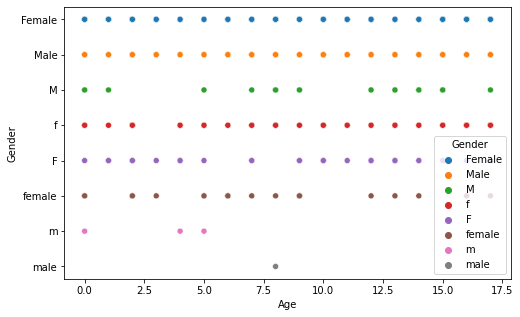

In [60]:
#scatterplot to view the age range for rows with nan values
plt.figure(figsize=(8,5))
chart_2 = sns.scatterplot(data=census_1881[census_1881['Marital Status'].isna()], y = 'Gender', x = 'Age', hue = 'Gender')
plt.show()

__From the above, it is clear that people with nan values are people aged 17 and below
<br> The nan values will easily be changed to Minor__

In [61]:
#using fillna, the nan values will be changed to Minor
census_1881['Marital Status'] = census_1881['Marital Status'].fillna('Minor')

__Final check for the unique values in the column__

In [62]:
#checking the unique values in the marital status column again
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Marital Status')

array(['Single', 'Minor', 'Divorced', 'Widowed', 'Married'], dtype=object)

### B(viii): Gender
__Dealing with the Gender Column__

In [63]:
#checking the unique values in the Gender column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Gender')

array(['Female', 'Male', 'female', 'm', 'f', 'M', 'F', 'male', ' '],
      dtype=object)

__Obvious errors from the unique data above include:__
<br>- Upper and lower case characters used interchangeably
<br>- Letters used in place of words
<br>- Blank data represented with ' '

__To address these errors, the following will be done:__
<br>- replace character case and letters errors
<br>- Then deal with the blank data

In [64]:
#dealing with the character case and letters errors using replace
census_1881['Gender'] = census_1881['Gender'].replace('female', 'Female').replace('f', 'Female').replace('F', 'Female').replace('male', 'Male').replace('m', 'Male').replace('M', 'Male')

__Next steps will involve dealing with blank values.__

In [65]:
#checking the rows where are there blank values
census_1881.loc[(census_1881['Gender'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3266,15,Bruce Mountain,Billy,Hunt,38,None,Single,,Equality and diversity officer,None,Methodist,35-39
6441,33,Chemist Union,Stewart,McCarthy,31,Head,Divorced,,Equality and diversity officer,None,Catholic,30-34
6525,4,Lawrence Court,Laura,Thomas,29,Head,Single,,"Buyer, industrial",None,Catholic,25-29


__It is not immediately clear what the gender should be based on the quick check done above. The next step will be to check the households to see if the dynamics give an insight as to the genders of the people above.__

__Checking the data for row 3266__

In [66]:
#checking the household for the for row 3266
#using the check_hh function
check_hh(census_1881,'House Number','Street',15,'Bruce Mountain')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
3264,15,Bruce Mountain,Jake,Wood,59,Head,Single,Male,Hospital pharmacist,None,Christian,55-59
3265,15,Bruce Mountain,Carly,Lee,54,None,Single,Female,"Investment banker, corporate",None,Christian,50-54
3266,15,Bruce Mountain,Billy,Hunt,38,None,Single,,Equality and diversity officer,None,Methodist,35-39
3267,15,Bruce Mountain,Joan,Smith,19,None,Single,Female,University Student,None,None,15-19


__The dynamics of the household does not make it clear as to what the gender should be. Therefore, another check will be done to see what the common gender is for the the First Name Billy__. 

In [67]:
census_1881.loc[(census_1881['First Name'] == 'Billy')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
91,12,Magicianplace Lane,Billy,Gray,16,Son,Minor,Male,Student,None,NaN,15-19
134,1,September Neck,Billy,Edwards,9,Son,Minor,Male,Student,None,NaN,5-9
279,28,Holly Forge,Billy,Walsh,28,Sibling,Single,Male,"Psychologist, counselling",None,Muslim,25-29
820,3,Bevan Gardens,Billy,Iqbal,38,Head,Divorced,Male,Further education lecturer,None,Catholic,35-39
987,48,Grapevat Avenue,Billy,Daly,3,Son,Minor,Male,Child,None,NaN,0-4
1181,14,Victoria Valley,Billy,Robertson,54,Husband,Married,Male,Armed forces technical officer,None,Christian,50-54
1722,157,Victoria Valley,Billy,Jones,7,Son,Minor,Male,Student,None,NaN,5-9
1897,8,Greencharm Street,Billy,Patel,22,None,Single,Male,University Student,None,Methodist,20-24
2128,13,Dragons Mountain,Billy,Curtis,27,Head,Single,Male,Unemployed,None,None,25-29
2453,71,Douglas Street,Billy,Jones,38,None,Single,Male,"Engineer, water",None,Christian,35-39


__From the above, it clear that the name Billy is typically associated with Males. Therefore, the blank data for Billy will be changed to Male.__

In [68]:
#replacing the gender data for Billy Hunt to Male
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Billy') & (census_1881['Surname'] == 'Hunt') & (census_1881['House Number'] == 15) &
(census_1881['Street'] == 'Bruce Mountain'), 'Gender'] = 'Male'

__Next, checking the data for row 6441__

In [69]:
#checking the household for the for row 6441
#using the check_hh function
check_hh(census_1881,'House Number','Street',33,'Chemist Union')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
6441,33,Chemist Union,Stewart,McCarthy,31,Head,Divorced,,Equality and diversity officer,None,Catholic,30-34


__The household consists of only one person.__
<br> __In this case, an assumption will be made based on the name of the person involved - a general assumption regarding what male names were like when the census was conducted (__[Baby Names](https://babynames.com/name/stewart)__). Also, the dominant gender in the dataset for the First Name Stewart is Male__

In [70]:
census_1881.loc[(census_1881['First Name'] == 'Stewart')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
692,24,Wessex Lane,Stewart,Hodgson,5,Son,Minor,Male,Student,None,NaN,5-9
778,4,Manor Avenue,Stewart,Lowe,6,Son,Minor,Male,Student,None,NaN,5-9
1455,86,Victoria Valley,Stewart,Carter,17,Son,Minor,Male,Student,None,NaN,15-19
2027,2,Parrot Road,Stewart,Lewis,58,Head,Single,Male,Food technologist,None,Catholic,55-59
2177,30,Dragons Mountain,Stewart,Turner,49,Head,Married,Male,Psychiatrist,None,Catholic,45-49
2316,20,Douglas Street,Stewart,Ward,18,None,Single,Male,Student,None,NaN,15-19
2342,30,Douglas Street,Stewart,Stevenson,57,Partner,Single,Male,Stage manager,None,Catholic,55-59
2437,64,Douglas Street,Stewart,Douglas,87,Head,Married,Male,Retired Chemical engineer,None,None,85-89
2920,2,Church Lane,Stewart,Reid,53,Head,Single,Male,Environmental health practitioner,None,Christian,50-54
2990,17,Christmas Road,Stewart,Morgan,17,Son,Minor,Male,Student,None,NaN,15-19


In [71]:
#replacing the gender data for Stewart McCarthy to Male
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Stewart') & (census_1881['Surname'] == 'McCarthy') & (census_1881['House Number'] == 33) &
(census_1881['Street'] == 'Chemist Union'), 'Gender'] = 'Male'

__Next, checking the data for row 6525__

In [72]:
#checking the household for the for row 6525
#using the check_hh function
check_hh(census_1881,'House Number','Street',4,'Lawrence Court')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
6525,4,Lawrence Court,Laura,Thomas,29,Head,Single,,"Buyer, industrial",None,Catholic,25-29
6526,4,Lawrence Court,Louis,Singh,31,Partner,Single,Male,Diplomatic Services operational officer,None,Catholic,30-34


__Going by the most likely conventions as at when the census was done, relationships would mostly involve male and females. Therefore, for row 6525, given that the two people in the household are most likely in a relationship and there's already a male gender, an assumption can be made that Laura Thomas is female.__

__Therefore, the missing data in this case will be female. Also, a quick check below shows that for the First Name Laura, the dominant gender is female.__

In [73]:
#checking for the rows where the First Name is Laura
census_1881.loc[(census_1881['First Name'] == 'Laura')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
89,12,Magicianplace Lane,Laura,Gray,39,Head,Married,Female,Jewellery designer,None,Catholic,35-39
351,18,CherryChestnut Lane,Laura,Campbell,40,Head,Married,Female,Electrical engineer,None,None,40-44
636,2,Wessex Lane,Laura,Johnson,42,Wife,Married,Female,Fitness centre manager,None,None,40-44
700,27,Wessex Lane,Laura,Gill,41,Head,Single,Female,Pathologist,None,Sikh,40-44
792,9,Manor Avenue,Laura,Akhtar,23,Wife,Married,Female,Unemployed,None,None,20-24
967,35,Grapevat Avenue,Laura,Mellor,51,Head,Single,Female,"Development worker, community",None,None,50-54
1558,114,Victoria Valley,Laura,Allen,17,Daughter,Minor,Female,Student,None,NaN,15-19
2485,81,Douglas Street,Laura,Baxter,70,Head,Widowed,Female,Retired Learning mentor,None,Christian,70-74
2506,90,Douglas Street,Laura,Wood,31,Head,Single,Female,"Psychologist, sport and exercise",None,Catholic,30-34
3326,39,Bruce Mountain,Laura,Arnold,39,Partner,Single,Female,Volunteer coordinator,None,Catholic,35-39


In [74]:
#replacing the gender data for Laura Thomas to female
#This is based on the assumption made above
census_1881.loc[(census_1881['First Name'] == 'Laura') & (census_1881['Surname'] == 'Thomas') & (census_1881['House Number'] == 4) &
(census_1881['Street'] == 'Lawrence Court'), 'Gender'] = 'Female'

__Final checks of the unique data in the Gender column__

In [75]:
#checking the unique values in the Gender column again
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Gender')

array(['Female', 'Male'], dtype=object)

### B(ix): Occupation
__Dealing with the Occupation Column__

In [76]:
#checking the unique values in the Occupation column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Occupation')

array(['Mechanical engineer', 'Child', 'Training and development officer',
       ..., 'Retired Occupational psychologist',
       'Retired Patent examiner',
       'Retired Accountant, chartered public finance'], dtype=object)

In [77]:
#checking the rows to see if there are nan values as it's not obvious from using the unique method
census_1881.loc[(census_1881['Occupation'].isna())]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range


__No nan values in the column__

In [78]:
#checking the rows whethere there is blank data as it's not obvious from using the unique method
census_1881.loc[(census_1881['Occupation'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
6332,21,Smith Street,Mohammad,Knight,93,Husband,Married,Male,,None,None,90-94


__There is one person whose occupation is blank and the person is aged 93 years old, which means they are most likely retired.__

In [79]:
#check most common occupation for people aged 90-94 on the same street
census_1881.loc[(census_1881['Age_range'] == '90-94') & (census_1881['Street'] == 'Smith Street') & (census_1881['Gender'] == 'Male')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
6332,21,Smith Street,Mohammad,Knight,93,Husband,Married,Male,,None,None,90-94


In [80]:
#check most common occupation for people aged 93
census_1881.loc[(census_1881['Age'].between(90,95))]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
2120,8,Dragons Mountain,Hugh,Hayes,90,Husband,Married,Male,"Retired Teacher, English as a foreign language",None,None,90-94
2809,4,Lancelotthwaite Drive,Julia,Hawkins,95,Head,Married,Female,Retired Field trials officer,None,Christian,95-99
3042,23,Arch Drive,Charlie,Williams,93,Head,Divorced,Male,"Retired Solicitor, Scotland",None,None,90-94
3257,11,Bruce Mountain,Jenna,Jones,93,Head,Married,Female,Retired Proofreader,None,Christian,90-94
3258,11,Bruce Mountain,Lawrence,Jones,94,Husband,Married,Male,Retired Materials engineer,None,Christian,90-94
3482,95,Bruce Mountain,Josh,Lewis-Lynch,91,Husband,Married,Male,"Retired Surveyor, building control",None,None,90-94
3589,130,Bruce Mountain,Louis,Cox,93,Husband,Married,Male,Retired Probation officer,None,None,90-94
4552,198,Turner Stream,Jennifer,Taylor,91,Head,Widowed,Female,Retired Community education officer,None,None,90-94
6332,21,Smith Street,Mohammad,Knight,93,Husband,Married,Male,,None,None,90-94


In [81]:
#checking the most common occupation among the different age groups
census_1881.Occupation.groupby(census_1881['Age_range']).agg(lambda g: g.mode()).reset_index()

,Age_range,Occupation
0,0-4,Child
1,5-9,Student
2,10-14,Student
3,15-19,Student
4,20-24,University Student
5,25-29,Unemployed
6,30-34,Unemployed
7,35-39,Unemployed
8,40-44,Unemployed
9,45-49,Unemployed


In [82]:
#checking for the number of people aged 70+ that are unemployed
census_1881.loc[(census_1881['Age'].between(70,106)) & (census_1881['Occupation'] == 'Unemployed') ]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
492,35,Cannon Road,Lesley,Dennis,72,Head,Divorced,Female,Unemployed,None,Christian,70-74
978,43,Grapevat Avenue,Catherine,Smith,73,Head,Divorced,Female,Unemployed,None,Christian,70-74
1336,56,Victoria Valley,Caroline,Walsh,73,Head,Widowed,Female,Unemployed,None,Christian,70-74
1575,118,Victoria Valley,Albert,Barrett,78,Husband,Married,Male,Unemployed,None,Christian,75-79
1764,169,Victoria Valley,Joanne,White,73,Head,Widowed,Female,Unemployed,None,None,70-74
1972,11,Jones Harbor,Cameron,Jackson,84,Head,Married,Male,Unemployed,None,Christian,80-84
2200,4,Payne Hill,Rachel,Butcher,73,Head,Widowed,Female,Unemployed,None,Christian,70-74
2447,69,Douglas Street,Natalie,James,70,Head,Divorced,Female,Unemployed,None,Christian,70-74
2498,87,Douglas Street,Marian,Peters,81,Head,Widowed,Female,Unemployed,None,None,80-84
2940,1,Christmas Road,Jasmine,Turner,74,Head,Widowed,Female,Unemployed,None,Christian,70-74


In [83]:
#Checking the unique occupation for people aged 68+
census_1881[census_1881['Age'].between(68,106)].Occupation.unique()

array(['Retired Patent attorney', 'Retired Aeronautical engineer',
       'Retired Nature conservation officer',
       'Retired Commercial horticulturist',
       'Retired Commercial/residential surveyor', 'Retired Writer',
       'Retired Oncologist', 'Retired Buyer, retail', 'Retired Dentist',
       'Retired Web designer', 'Retired Accountant, chartered management',
       'Retired Conference centre manager',
       'Retired Merchant navy officer',
       'Retired Teacher, special educational needs',
       'Retired Administrator', 'Retired Civil Service administrator',
       'Retired Research scientist (life sciences)',
       'Retired Wellsite geologist',
       'Retired Lighting technician, broadcasting/film/video',
       'Retired Audiological scientist',
       'Retired Water quality scientist', 'Retired Haematologist',
       'Retired Advertising account planner',
       'Retired Editor, film/video',
       'Retired Control and instrumentation engineer',
       'Retired Tech

In [84]:
#checking at what age the retired category for occupation typically comes up
#this will be done by checking where the occupation starts with the srting Retir

retirement_age  = census_1881.loc[census_1881['Occupation'].str.startswith('Retir', na=False)]
#using the check_unique function we created earlier
np.sort(check_unique(retirement_age,'Age'))

array([ 68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  93,  94,
        95,  96,  97,  98,  99, 100, 102, 104, 105, 106])

__From the different points above, there is a question of whether someone aged 68+ should be considered unemployed, seeing that all the other people in the same age group are all retired.__

__In this case, an argument can be made for the people regarded as unemployed be changed to a general Retired, and the person with the blank value be changed to Retired as well.__

In [85]:
#replacing the occupation value unemployed for people aged 75+ and blank data to Retired
#This is based on the assumption made above
census_1881.loc[(census_1881['Age'].between(68,106)) & (census_1881['Occupation'] == 'Unemployed'), 'Occupation'] = 'Retired'
census_1881.loc[(census_1881['Age'].between(68,106)) & (census_1881['Occupation'] == ' '), 'Occupation'] = 'Retired'

In [86]:
#checking that the rows with unemployed and blank data has been changed to Retired for people aged 75+
census_1881.loc[(census_1881['Occupation'] == 'Retired')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
492,35,Cannon Road,Lesley,Dennis,72,Head,Divorced,Female,Retired,None,Christian,70-74
978,43,Grapevat Avenue,Catherine,Smith,73,Head,Divorced,Female,Retired,None,Christian,70-74
1203,20,Victoria Valley,Jessica,Burke,68,Head,Divorced,Female,Retired,None,Methodist,65-69
1336,56,Victoria Valley,Caroline,Walsh,73,Head,Widowed,Female,Retired,None,Christian,70-74
1575,118,Victoria Valley,Albert,Barrett,78,Husband,Married,Male,Retired,None,Christian,75-79
1764,169,Victoria Valley,Joanne,White,73,Head,Widowed,Female,Retired,None,None,70-74
1972,11,Jones Harbor,Cameron,Jackson,84,Head,Married,Male,Retired,None,Christian,80-84
2200,4,Payne Hill,Rachel,Butcher,73,Head,Widowed,Female,Retired,None,Christian,70-74
2447,69,Douglas Street,Natalie,James,70,Head,Divorced,Female,Retired,None,Christian,70-74
2498,87,Douglas Street,Marian,Peters,81,Head,Widowed,Female,Retired,None,None,80-84


__The above rectifies the population aged 68+ whose occupation had been previously recorded as unemployed and blank data - with these being changed to Retired.__

__Next, a couple of points will be checked, such as:__
<br> - Are there errors with different age groups and their occupation - kids for example should not be counted as working or unemployed.
<br> - People aged 5 and above should not be counted as a child
<br> - People above a certain age should not be counted as a student
<br> - In the event that there are issues, these issues will need to be addressed

In [87]:
#Checking the unique occupation for people aged 0-4
census_1881[census_1881['Age_range'] == '0-4'].Occupation.unique()

array(['Child'], dtype=object)

In [88]:
#Checking the unique occupation for people aged 5-9
census_1881[census_1881['Age_range'] == '5-9'].Occupation.unique()

array(['Student'], dtype=object)

In [89]:
#Checking the unique occupation for people aged 10-14
census_1881[census_1881['Age_range'] == '10-14'].Occupation.unique()

array(['Student'], dtype=object)

In [90]:
#Checking the unique occupation for people aged 15-19
census_1881[census_1881['Age_range'] == '15-19'].Occupation.unique()

array(['Student', 'University Student', 'Warehouse manager',
       'Clinical embryologist', 'Engineer, control and instrumentation',
       'Chemist, analytical', 'Chief Strategy Officer',
       'Historic buildings inspector/conservation officer',
       'Advertising copywriter', 'Contracting civil engineer',
       'Web designer', 'Manufacturing engineer',
       'Armed forces technical officer',
       'Senior tax professional/tax inspector', 'Herpetologist',
       'Financial planner', 'Legal executive', 'Communications engineer',
       'Actuary', 'Press photographer'], dtype=object)

In [91]:
#Checking the unique occupation for people aged 15-18
census_1881[census_1881['Age'].between(15,18)].Occupation.unique()

array(['Student', 'University Student'], dtype=object)

__For people aged 15-19 there are students in the group. More checks will be done to see the age of people 15-19 who are classed as students__

In [92]:
#check to see if people aged 19+ are classed as students
#if there are, this will need to be addressed
census_1881.loc[(census_1881['Age'] >= 19) & (census_1881['Occupation'] == 'Student')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range


In [93]:
#check to see if people aged 19+ are classed as child
census_1881.loc[(census_1881['Age'] >= 19) & (census_1881['Occupation'] == 'Child')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range


__The data for people aged 15-19 and 19+ is in order and no changes are required__

### B(x): Infirmity
__Dealing with the Infirmity Column__

In [94]:
#checking the unique values in the Infirmity column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Infirmity')

array(['None', 'Deaf', 'Physical Disability', 'Blind', ' ',
       'Mental Disability', 'Unknown Infection'], dtype=object)

__The only error observed above relate to the blank data in the dataset represented by ' '. This will be handled appropriately.__

In [95]:
#checking the rows where there is blank data
census_1881.loc[(census_1881['Infirmity'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
985,48,Grapevat Avenue,Kerry,Daly,38,Head,Single,Female,"Merchandiser, retail",,Methodist,35-39
2696,1,Hereford Brooks,Leigh,King-Davies,42,Son,Single,Male,Unemployed,,None,40-44
2848,2,Minster Lane,Jacqueline,Talbot,65,Wife,Married,Female,Animator,,None,65-69
4755,64,Oak Drive,Lindsey,Howells,53,Wife,Married,Female,Hydrologist,,Christian,50-54
4807,95,Oak Drive,Diane,Stephenson,74,Wife,Married,Female,Retired Clinical research associate,,None,70-74
5146,23,Chemist Run,Leah,Sanders,44,Lodger,Single,Female,"Surveyor, planning and development",,None,40-44
5497,47,Murphy River,Marcus,Chandler,60,None,Single,Male,"Therapist, art",,Catholic,60-64
7018,7,Lavendar Lane,Sean,Brown,56,Husband,Married,Male,Technical brewer,,None,55-59
8333,36,Solstice Island,Gordon,Smith,32,Husband,Married,Male,Sports therapist,,Catholic,30-34


__From the above, there are 9 rows for which the infirmity data is missing. As it stands, imputing this missing data using household dynamics will be difficult. In this case, the simplest option will be to assume that the people for which the data is missing have no infirmity.__

In [96]:
#checking the counts of rows for the different infirmities
census_1881['Infirmity'].value_counts()

None                   9317
Blind                    19
Physical Disability      18
Deaf                     10
                          9
Mental Disability         8
Unknown Infection         6
Name: Infirmity, dtype: int64

In [97]:
#replacing the blank values with None
census_1881['Infirmity'] = census_1881['Infirmity'].replace(' ', 'None')

In [98]:
#checking the unique values in the Infirmity column again
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Infirmity')

array(['None', 'Deaf', 'Physical Disability', 'Blind',
       'Mental Disability', 'Unknown Infection'], dtype=object)

### B(xi): Religion
__Dealing with the Religion Column__

In [99]:
#checking the unique values in the Religion column
#the function check_unique defined earlier will be used to do this
check_unique(census_1881,'Religion')

array(['Catholic', nan, 'Christian', 'None', 'Methodist', 'Muslim',
       'Sikh', 'Quaker', 'Jewish', ' ', 'Private', 'Buddist', 'Nope',
       'Housekeeper'], dtype=object)

__A quick look at the above unique values shows that there are errors with values such as private, nope, housekeeper and blank values.__

__Dealing with the Private religion error__

In [100]:
#checking for rows where the religion value is private
census_1881.loc[(census_1881['Religion'] == 'Private')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1670,144,Victoria Valley,Susan,Davies,58,Head,Divorced,Female,Unemployed,None,Private,55-59
1673,144,Victoria Valley,Diane,Davies,19,Daughter,Single,Female,University Student,None,Private,15-19


In [101]:
#checking household to see other religions
check_hh(census_1881,'House Number','Street',144,'Victoria Valley')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1670,144,Victoria Valley,Susan,Davies,58,Head,Divorced,Female,Unemployed,None,Private,55-59
1671,144,Victoria Valley,Donna,Davies,22,Daughter,Single,Female,University Student,None,None,20-24
1672,144,Victoria Valley,Kerry,Davies,22,Daughter,Single,Female,University Student,None,None,20-24
1673,144,Victoria Valley,Diane,Davies,19,Daughter,Single,Female,University Student,None,Private,15-19


__Just two people come up as having the religion private, and in that household, the other family members come up as none.
<br>From the above, the assumption will be made to change the religion private to None__

In [102]:
#replacing the religion value private with None
census_1881['Religion'] = census_1881['Religion'].replace('Private', 'None')

__Dealing with the Nope religion error__

In [103]:
#checking for rows where the religion value is Nope
census_1881.loc[(census_1881['Religion'] == 'Nope')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
4399,140,Turner Stream,Matthew,Summers,65,Head,Married,Male,Soil scientist,None,Nope,65-69
4400,140,Turner Stream,Kimberley,Summers,64,Wife,Married,Female,Manufacturing engineer,None,Nope,60-64
4418,147,Turner Stream,Georgia,Cole,18,None,Single,Female,University Student,None,Nope,15-19


In [104]:
#checking household to see other religions
check_hh(census_1881,'House Number','Street',140,'Turner Stream')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
4399,140,Turner Stream,Matthew,Summers,65,Head,Married,Male,Soil scientist,None,Nope,65-69
4400,140,Turner Stream,Kimberley,Summers,64,Wife,Married,Female,Manufacturing engineer,None,Nope,60-64


In [105]:
#checking household to see other religions
check_hh(census_1881,'House Number','Street',147,'Turner Stream')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
4417,147,Turner Stream,Sandra,Murphy,21,Head,Single,Female,University Student,None,None,20-24
4418,147,Turner Stream,Georgia,Cole,18,None,Single,Female,University Student,None,Nope,15-19


__In both households where the religion value is Nope, an assumption can be made to change the value to None as the household dynamics do not suggest any other religions__

In [106]:
#replacing the religion value Nope with None
census_1881['Religion'] = census_1881['Religion'].replace('Nope', 'None')

__Dealing with the Housekeeper religion error__

In [107]:
#checking for rows where the religion value is Housekeeper
census_1881.loc[(census_1881['Religion'] == 'Housekeeper')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
7785,1,Steel Creek,Gordon,Chadwick,37,Lodger,Single,Male,Learning mentor,None,Housekeeper,35-39


In [108]:
#checking household to see other religions
check_hh(census_1881,'House Number','Street',1,'Steel Creek')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
7781,1,Steel Creek,Denis,Brown,36,Head,Single,Male,Unemployed,None,None,35-39
7782,1,Steel Creek,Peter,Brown,1,Son,Minor,Male,Child,None,NaN,0-4
7783,1,Steel Creek,Lewis,Webb,22,Lodger,Widowed,Male,University Student,None,Catholic,20-24
7784,1,Steel Creek,Dominic,Smith,22,Lodger,Divorced,Male,University Student,None,None,20-24
7785,1,Steel Creek,Gordon,Chadwick,37,Lodger,Single,Male,Learning mentor,None,Housekeeper,35-39
7786,1,Steel Creek,Kenneth,Griffin,33,Sibling,Single,Male,Chief Operating Officer,None,None,30-34


__Going by the trend in this household - given the other lodgers have none, an assumption can be made to change the housekeeper value to None__

In [109]:
#replacing the religion value Housekeeper with None
census_1881['Religion'] = census_1881['Religion'].replace('Housekeeper', 'None')

__Dealing with the Blank religion error__

In [110]:
#checking for rows where the religion value is blank ''
census_1881.loc[(census_1881['Religion'] == ' ')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
791,9,Manor Avenue,Martyn,Akhtar,24,Head,Married,Male,Accommodation manager,None,,20-24


In [111]:
#checking household to see other religions
check_hh(census_1881,'House Number','Street',9,'Manor Avenue')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
791,9,Manor Avenue,Martyn,Akhtar,24,Head,Married,Male,Accommodation manager,None,,20-24
792,9,Manor Avenue,Laura,Akhtar,23,Wife,Married,Female,Unemployed,None,None,20-24


__Going by the trend in this household - given the other family member's religion is none, an assumption can be made to change the blank value to None__

In [112]:
#replacing the blank religion value with None
census_1881['Religion'] = census_1881['Religion'].replace(' ', 'None')

__Next is dealing with nan values__

In [113]:
#Checking the unique age where Religion is nan
np.sort(census_1881[census_1881['Religion'].isna()].Age.unique())

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 21, 22, 23, 25])

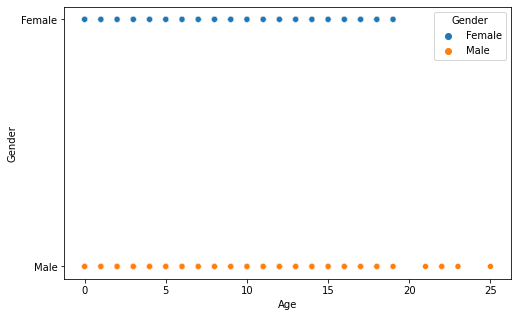

In [114]:
#scatterplot to view the age range for rows with nan values
plt.figure(figsize=(8,5))
chart_2 = sns.scatterplot(data=census_1881[census_1881['Religion'].isna()], y = 'Gender', x = 'Age', hue = 'Gender')
plt.show()

In [115]:
#checking to see the age of people with nan values in the religion column and the count
census_1881[census_1881['Religion'].isna()].Age.value_counts().sort_index()

0      91
1      94
2     109
3      99
4     115
5     131
6     111
7     109
8     119
9     126
10    129
11    107
12    148
13    130
14    169
15    153
16    156
17    130
18     39
19      5
21      1
22      2
23      1
25      1
Name: Age, dtype: int64

__From the above, it is clear that more people aged 17 and below have nan values in the religion column. 
<br> Ideas to deal with the nan values include:__
<br> - For people aged 18 and above, these people are considered adults and therefore even though their family might practice a certain religion, it is likely that they do not practice the same religion. Therefore, we will replace the people aged 18+ who have nan values as none.
<br> - For people aged 17 and below who are not head of house, imputations will be done with the aim of replacing the nan values with the religion of their parents/grandparents/guardians (based on surname) or in some cases head of house (where only one family live in the household).

In [116]:
#value counts for the Religion column
census_1881.Religion.value_counts()

None         3192
Christian    2103
Catholic      935
Methodist     632
Muslim        143
Sikh           59
Jewish         42
Quaker          4
Buddist         2
Name: Religion, dtype: int64

In [117]:
#checking the number of nan values
census_1881.isnull().sum()

House Number                        0
Street                              0
First Name                          0
Surname                             0
Age                                 0
Relationship to Head of House       0
Marital Status                      0
Gender                              0
Occupation                          0
Infirmity                           0
Religion                         2275
Age_range                           0
dtype: int64

__Replacing the nan values for people aged 18 and above with None__

In [118]:
#people aged 18+ with nan values in Religion column
census_1881.loc[(census_1881['Religion'].isna()) & (census_1881['Age'] >= 18)]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
53,22,Albert Inlet,Melanie,Cooper,18,Head,Married,Female,Student,None,NaN,15-19
54,22,Albert Inlet,Wayne,Cooper,19,Husband,Married,Male,University Student,None,NaN,15-19
58,24,Albert Inlet,Abdul,Davis,18,Head,Single,Male,Student,None,NaN,15-19
721,34,Wessex Lane,Jenna,Cook,18,Lodger,Single,Female,Student,None,NaN,15-19
808,6,Fry Extensions,Mathew,Black,18,Head,Single,Male,Student,None,NaN,15-19
823,5,Bevan Gardens,Damian,King,18,Head,Single,Male,Student,None,NaN,15-19
826,7,Bevan Gardens,Hannah,Martin,18,Head,Single,Female,Student,None,NaN,15-19
921,7,Grapevat Avenue,Rhys,Short,18,Head,Married,Male,Student,None,NaN,15-19
1044,9,Shrine Trail,Dale,Booth,18,Head,Single,Male,Student,None,NaN,15-19
1347,58,Victoria Valley,Antony,Townsend,18,None,Single,Male,Student,None,NaN,15-19


In [119]:
#replacing the nan values with None for people aged 18+ where the religion is nan
census_1881.loc[(census_1881['Religion'].isna()) & (census_1881['Age'] >= 18), 'Religion'] = 'None'

In [120]:
#checking the number of nan values
census_1881.isnull().sum()

House Number                        0
Street                              0
First Name                          0
Surname                             0
Age                                 0
Relationship to Head of House       0
Marital Status                      0
Gender                              0
Occupation                          0
Infirmity                           0
Religion                         2226
Age_range                           0
dtype: int64

<font color='green'><u>__Next is dealing with people aged 17 and below and head of house__

In [121]:
#people aged 17 and below who are head of house with nan values in Religion column
census_1881.loc[(census_1881['Religion'].isna()) & (census_1881['Age'] <= 17) & (census_1881['Relationship to Head of House'] == 'Head')]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1117,54,Shrine Trail,Hollie,Heath,15,Head,Minor,Female,Student,None,NaN,15-19
3406,74,Bruce Mountain,Eileen,Burgess,16,Head,Minor,Female,Student,None,NaN,15-19
7526,148,Lavendar Lane,Zoe,Roberts,17,Head,Married,Female,Student,None,NaN,15-19
8885,46,Taylor Lane,Beth,Lamb,17,Head,Minor,Female,Student,None,NaN,15-19


__The people above are less than 17 and below and head of house.
<br>They filled the census forms and left religion blank.
<br>This will be assumed to mean no religion (None), even though their partners might practice some sort of religion.__

In [122]:
#replacing the nan values with None for people aged 17 and below who are head of house where the religion is nan
census_1881.loc[(census_1881['Religion'].isna()) & (census_1881['Age'] <= 17) & (census_1881['Relationship to Head of House'] == 'Head'), 'Religion'] = 'None'

<font color='green'><u>__Next is dealing with people aged 17 and below and not head of house__

In [123]:
#rows with people aged 17 and below and not head of house with nan values in Religion column
pd.set_option('display.max_rows', None)
census_1881.loc[(census_1881['Religion'].isna())]

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
1,1,Albert Inlet,Jane,Burke,1,Daughter,Minor,Female,Child,None,NaN,0-4
14,7,Albert Inlet,Leslie,Wood,10,Son,Minor,Male,Student,None,NaN,10-14
17,8,Albert Inlet,Ronald,Mistry,3,Son,Minor,Male,Child,None,NaN,0-4
22,10,Albert Inlet,Charlene,Goddard,17,Daughter,Minor,Female,Student,None,NaN,15-19
23,10,Albert Inlet,Natalie,Goddard,14,Daughter,Minor,Female,Student,None,NaN,10-14
26,12,Albert Inlet,Kimberley,Baker,10,Daughter,Minor,Female,Student,None,NaN,10-14
27,12,Albert Inlet,Douglas,Baker,5,Son,Minor,Male,Student,None,NaN,5-9
28,12,Albert Inlet,Darren,Baker,4,Son,Minor,Male,Child,None,NaN,0-4
29,12,Albert Inlet,Denise,Baker,2,Daughter,Minor,Female,Child,None,NaN,0-4
33,14,Albert Inlet,Alice,Sheppard,16,Daughter,Minor,Female,Student,None,NaN,15-19


__The thinking to guide dealing with religion for people aged 17 and below is that since this is 1881 and even moreso today, it is highly likely that children will practice the same religion as their parents and would typically join their parents when they visit the places of worship. Therefore, the idea here will be that:__
<br> 1. Replace nan with the religion of the parent who appears first in the household list - this is because the data is structured in such a way that parents appear first in each household. The grouping code here will work based on people with the same house number, street and surnames. This is done first because it is possible that there might be housholds where there is more than one family
<br> 2. After the above, if there are still kids with nan values in Religion column, the next approach will be to replace with the religion of the head of house, where house number and street are the same. This is for situations where grouping done with surname does not work - cases where the kid do not bear the same surname as their parents or guardian (adopted, step children, grandchildren etc. - also since there are no kids that are lodgers).

In [124]:
#testing!!!
#check of the groupings by house number, street and surname
#the religion of the first in the group
religion_surname = census_1881.groupby(['House Number','Street','Surname'])['Religion'].first()
religion_surname_df = religion_surname.to_frame()
religion_surname_df.reset_index(inplace=True)
religion_surname_df

,House Number,Street,Surname,Religion
0,1,Albert Inlet,Burke,Catholic
1,1,Albert Inlet,Roberts,Christian
2,1,Albion Drive,Gibbs,Christian
3,1,Ambrosia Bypass,Roberts,Catholic
4,1,Anglia Overpass,King,Methodist
5,1,Appletree Factory,Preston,None
6,1,Appletree Factory,Watts,None
7,1,Arch Drive,Cooper,Christian
8,1,Armagh Road,Lewis,Christian
9,1,Atlantis Avenue,Miah,Methodist


In [125]:
#testing!!!
#check of the groupings by house number and street only
#the religion of the first in the group
religion_head = census_1881.groupby(['House Number','Street'])['Religion'].first()
religion_head_df = religion_head.to_frame()
religion_head_df.reset_index(inplace=True)
religion_head_df

,House Number,Street,Religion
0,1,Albert Inlet,Catholic
1,1,Albion Drive,Christian
2,1,Ambrosia Bypass,Catholic
3,1,Anglia Overpass,Methodist
4,1,Appletree Factory,None
5,1,Arch Drive,Christian
6,1,Armagh Road,Christian
7,1,Atlantis Avenue,Methodist
8,1,August Lane,Catholic
9,1,Autumn Avenue,None


__The first step, which is about grouping by house number, street and surname, and filling the nan with the value of the religion practiced by the first member of the family, which is one of the parents.__

In [126]:
#checking the number of nan values before running the steps
census_1881.isnull().sum()

House Number                        0
Street                              0
First Name                          0
Surname                             0
Age                                 0
Relationship to Head of House       0
Marital Status                      0
Gender                              0
Occupation                          0
Infirmity                           0
Religion                         2222
Age_range                           0
dtype: int64

In [127]:
#https://towardsdatascience.com/how-to-fill-missing-data-with-pandas-8cb875362a0d
#https://stackoverflow.com/questions/15001237/how-to-apply-first-and-last-functions-to-columns-while-using-group-by-in-pan

#fillna using the value of the religion of the first person in the family(a parent) with the same surname
census_1881['Religion'] = census_1881.groupby(['House Number','Street','Surname'])['Religion'].transform(lambda x: x.fillna(x.iloc[0]))
census_1881

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
0,1,Albert Inlet,Lynda,Burke,38,Head,Single,Female,Mechanical engineer,None,Catholic,35-39
1,1,Albert Inlet,Jane,Burke,1,Daughter,Minor,Female,Child,None,Catholic,0-4
2,1,Albert Inlet,Gerard,Roberts,31,Lodger,Divorced,Male,Training and development officer,None,Christian,30-34
3,2,Albert Inlet,Trevor,Newman,59,Head,Single,Male,Arts administrator,None,None,55-59
4,3,Albert Inlet,Guy,Armstrong,74,Head,Divorced,Male,Retired Patent attorney,None,None,70-74
5,4,Albert Inlet,Carol,Jackson,98,Head,Widowed,Female,Retired Aeronautical engineer,None,None,95-99
6,5,Albert Inlet,Beth,Watson,51,Head,Married,Female,"Nurse, children's",None,Christian,50-54
7,5,Albert Inlet,Vincent,Watson,59,Husband,Married,Male,Structural engineer,Deaf,None,55-59
8,5,Albert Inlet,Lawrence,Watson,37,Son,Single,Male,"Editor, commissioning",None,Christian,35-39
9,5,Albert Inlet,Arthur,Watson,36,Son,Divorced,Male,Automotive engineer,None,Christian,35-39


In [128]:
#doing a check of the Holt family who live in the same household as the Jones family
#The fillna was done correctly based on the surname
check_hh(census_1881,'House Number','Street',6,'Sandy Meadows')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
6579,6,Sandy Meadows,Cheryl,Jones,79,Head,Married,Female,"Retired Buyer, industrial",None,None,75-79
6580,6,Sandy Meadows,Bernard,Jones,79,Husband,Married,Male,Retired Ophthalmologist,None,None,75-79
6581,6,Sandy Meadows,Charlene,Holt,56,None,Married,Female,Horticultural therapist,None,Methodist,55-59
6582,6,Sandy Meadows,Leslie,Holt,61,None,Married,Male,"Surveyor, minerals",None,None,60-64
6583,6,Sandy Meadows,Elizabeth,Holt,25,None,Single,Female,"Engineer, manufacturing systems",None,None,25-29
6584,6,Sandy Meadows,Lee,Holt,23,None,Single,Male,Artist,None,Methodist,20-24
6585,6,Sandy Meadows,Charles,Holt,23,None,Single,Male,Herbalist,None,Methodist,20-24
6586,6,Sandy Meadows,Donna,Holt,20,None,Single,Female,University Student,None,None,20-24
6587,6,Sandy Meadows,Mohammed,Holt,16,None,Minor,Male,Student,None,Methodist,15-19


In [129]:
#checking the number of null values after the first step using house number, street and surname
census_1881.isnull().sum()

House Number                       0
Street                             0
First Name                         0
Surname                            0
Age                                0
Relationship to Head of House      0
Marital Status                     0
Gender                             0
Occupation                         0
Infirmity                          0
Religion                         258
Age_range                          0
dtype: int64

__There are still null values, therefore, the next step using head of house will be carried out.__

In [130]:
#fillna using the value of the religion of the head of house, in cases where kids might be step children
#or simply have different names from parents or live with guardians such as grandparents
census_1881['Religion'] = census_1881.groupby(['House Number','Street'])['Religion'].transform(lambda x: x.fillna(x.iloc[0]))
census_1881

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
0,1,Albert Inlet,Lynda,Burke,38,Head,Single,Female,Mechanical engineer,None,Catholic,35-39
1,1,Albert Inlet,Jane,Burke,1,Daughter,Minor,Female,Child,None,Catholic,0-4
2,1,Albert Inlet,Gerard,Roberts,31,Lodger,Divorced,Male,Training and development officer,None,Christian,30-34
3,2,Albert Inlet,Trevor,Newman,59,Head,Single,Male,Arts administrator,None,None,55-59
4,3,Albert Inlet,Guy,Armstrong,74,Head,Divorced,Male,Retired Patent attorney,None,None,70-74
5,4,Albert Inlet,Carol,Jackson,98,Head,Widowed,Female,Retired Aeronautical engineer,None,None,95-99
6,5,Albert Inlet,Beth,Watson,51,Head,Married,Female,"Nurse, children's",None,Christian,50-54
7,5,Albert Inlet,Vincent,Watson,59,Husband,Married,Male,Structural engineer,Deaf,None,55-59
8,5,Albert Inlet,Lawrence,Watson,37,Son,Single,Male,"Editor, commissioning",None,Christian,35-39
9,5,Albert Inlet,Arthur,Watson,36,Son,Divorced,Male,Automotive engineer,None,Christian,35-39


In [131]:
#doing a check of the Woodward family, a case where the mother has different surnames to her kids
#the fillna has been done correctly as shown below
check_hh(census_1881,'House Number','Street',4,'September Neck')

,House Number,Street,First Name,Surname,Age,Relationship to Head of House,Marital Status,Gender,Occupation,Infirmity,Religion,Age_range
145,4,September Neck,Stacey,Woodward,29,Head,Single,Female,Mental health nurse,None,None,25-29
146,4,September Neck,Heather,Knowles-Woodward,5,Daughter,Minor,Female,Student,None,None,5-9
147,4,September Neck,Terence,Knowles-Woodward,2,Son,Minor,Male,Child,None,None,0-4


In [133]:
#checking the number of null values after the second step using house number and street
census_1881.isnull().sum()

House Number                     0
Street                           0
First Name                       0
Surname                          0
Age                              0
Relationship to Head of House    0
Marital Status                   0
Gender                           0
Occupation                       0
Infirmity                        0
Religion                         0
Age_range                        0
dtype: int64

__All the cleaning steps have been completed. Next is analysing and visualising the data__

## Section 2: Data exploration and statistical analysis

### A(i): Population Data
__This section will explore the population dynamics for the town__

__General Population Statistics__

In [134]:
#exploring the town's population data

#total population
total_population = len(census_1881)
male_population = census_1881[census_1881['Gender'] == 'Male']
female_population = census_1881[census_1881['Gender'] == 'Female']
total_male_population = len(census_1881[census_1881['Gender'] == 'Male'])
total_female_population = len(census_1881[census_1881['Gender'] == 'Female'])

#mean and medians of the population
median_age = census_1881['Age'].median()
mean_age = census_1881['Age'].mean()
median_age_male = male_population['Age'].median()
mean_age_male = male_population['Age'].mean()
median_age_female = female_population['Age'].median()
mean_age_female = female_population['Age'].mean()

#printing out the results
print ('The total population of the town is :', total_population)
print ('The total male population is :', total_male_population)
print ('The total female population is :', total_female_population)
print (f'Male share of the total population is {(total_male_population / total_population)*100:.2f}%')
print (f'Female share of the total population is {(total_female_population / total_population)*100:.2f}%')

print ('The median age is :', median_age)
print (f'The mean age is : {mean_age:.2f}')
print ('The median male age is :', median_age_male)
print (f'The mean male age is: {mean_age_male:.2f}')
print ('The median female age is :', median_age_female)
print (f'The mean female age is {mean_age_female:.2f}')

The total population of the town is : 9387
The total male population is : 4534
The total female population is : 4853
Male share of the total population is 48.30%
Female share of the total population is 51.70%
The median age is : 35.0
The mean age is : 35.81
The median male age is : 34.0
The mean male age is: 35.44
The median female age is : 36.0
The mean female age is 36.16


In [313]:
#population dynamics
#split of groups and dependency
children = len(census_1881[(census_1881['Age'].between(0,17))])
old_people = len(census_1881[(census_1881['Age'] >=68)])
work_age = len(census_1881[(census_1881['Age'].between(18,67))])

print (f'The population of children (0-14) : {children}')
print (f'The population of old people (68+) : {old_people}')
print (f'The working age population (18-67) : {work_age}\n')

print (f'The proportion of children : {(children/total_population)*100:.2f}%')
print (f'The proportion of old people : {(old_people/total_population)*100:.2f}%')
print (f'The old people to young people ratio : {(old_people/children)*100:.2f}%\n')

print (f'The youth dependency ratio : {((children)/work_age)*100:.2f}%')
print (f'The old age dependency ratio : {((old_people)/work_age)*100:.2f}%')
print (f'The total dependency ratio : {((old_people+children)/work_age)*100:.2f}%')

The population of children (0-14) : 2226
The population of old people (68+) : 831
The working age population (18-67) : 6330

The proportion of children : 23.71%
The proportion of old people : 8.85%
The old people to young people ratio : 37.33%

The youth dependency ratio : 35.17%
The old age dependency ratio : 13.13%
The total dependency ratio : 48.29%


In [ ]:
#population by age group plot
sns.set_style('darkgrid')

plt.figure(figsize=(17,9))
population_age_group_plot = sns.countplot(data=census_1881,
                                     x ='Age_range', 
                                     palette = 'crest',
                                     edgecolor='black',
                                     alpha=0.75,
                                     linewidth=1.5)

for bars in population_age_group_plot.containers:
    population_age_group_plot.bar_label(bars,padding=4,fontsize=14)

plt.tick_params(bottom=True, left=True)
plt.yticks(fontsize = 11)
plt.xticks(fontsize = 11)
plt.title('\nTotal Population by Age Group\n', fontsize=20,fontweight='bold')
plt.xlabel('Age groups', fontsize = 11,fontweight='bold')
sns.despine(top=False, right=True, left=False, bottom=False)
plt.show()

In [ ]:
#population by age group and gender plot
sns.set_style('darkgrid')

plt.figure(figsize=(16,8))
population_age_group_gender = sns.countplot(data=census_1881,
                                     x ='Age_range', 
                                     hue = 'Gender',
                                     palette = 'crest',
                                     edgecolor='black',
                                     alpha=0.75,
                                     linewidth=1.5)

plt.tick_params(bottom=True, left=True)
plt.yticks(fontsize = 11)
plt.xticks(fontsize = 11)
plt.title('\nTotal Population by Age Group and Gender\n', fontsize=20,fontweight='bold')
plt.xlabel('Age groups', fontsize = 11,fontweight='bold')
sns.despine(top=False, right=True, left=False, bottom=False)
plt.show()

__To plot the age pyramid, quick adjustments will be done to create a dataframe which only contains age_range and gender__

In [137]:
#creating a dataframe which only contains the age_range and gender
gender_range = census_1881[['Age_range','Gender']].value_counts().sort_index().to_frame().reset_index()
gender_range

,Age_range,Gender,0
0,0-4,Female,259
1,0-4,Male,249
2,5-9,Female,302
3,5-9,Male,294
4,10-14,Female,311
5,10-14,Male,372
6,15-19,Female,369
7,15-19,Male,376
8,20-24,Female,390
9,20-24,Male,370


In [179]:
#pivoting the newly created df to make the gender names headers
gender_df = gender_range.pivot_table(index='Age_range', columns=['Gender'], values='Age_range', aggfunc=sum)
gender_df.reset_index(inplace=True)
gender_df

Gender,Age_range,Female,Male
0,0-4,259,249
1,5-9,302,294
2,10-14,311,372
3,15-19,369,376
4,20-24,390,370
5,25-29,330,295
6,30-34,384,327
7,35-39,414,358
8,40-44,424,365
9,45-49,376,297


In [ ]:
#plotting the population pyramide
#https://maciejtarsa.medium.com/plotting-a-population-pyramid-in-python-52be034968b0

gender_df['Male'] = gender_df['Male'] / -1
gender_df['Female'] = gender_df['Female'] / 1

ages = ['100+', '95-99', '90-94', '85-89','80-84','75-79','70-74',
        '65-69', '60-64','55-59', '50-54', '45-49','40-44','35-39', 
        '30-34', '25-29', '20-24', '15-19', '10-14', '5-9', '0-4']

sns.set_style('darkgrid')

plt.figure(figsize=(15,13))
ax1 = sns.barplot(x = 'Male', y = 'Age_range', data = gender_df, order = ages, palette ='dark:salmon_r')
ax2 = sns.barplot(x='Female', y='Age_range', data=gender_df, order=ages, palette='mako')
plt.title('\nPopulation Pyramid\n', fontsize=20,fontweight='bold')
plt.xlabel('\nMale                  Female',fontsize=12,fontweight='bold')
plt.ylabel('\nAge Range\n',fontsize=12,fontweight='bold')
plt.grid()
plt.xticks(ticks=[-100, -200, -300, -400, -500, 0, 100, 200, 300, 400, 500],
labels=['100', '200', '300', '400', '500', '0', '100', '200', '300', '400', '500'])
plt.show()

### A(ii): Other population Dynamics
__The focus of this section will be to estimate the town's population rate of change. To do this, a couple of variables will be estimated which will help calculate the rate of change. Variables to be calculated include__:
<br> 1. Birth rate in the town
<br> 2. Death rate in the town
<br> 3. Population rate of natural increase
<br> 4. Marriage and Divorce rates in the town
<br> 5. Immigration rate into the town and Emigration rate out of the town
<br> 6. Population Growth



<u> __1. Dealing with Birth Rate__
    
To calculate birth rate, the formula for crude birth rate of __(Live Births/Mid-year population) * 1000__ will be adopted (__[ONS](https://www.ons.gov.uk/peoplepopulationandcommunity/birthsdeathsandmarriages/livebirths/methodologies/userguidetobirthstatistics)__)

__Relevant assumptions:__
- Live births is the number of kids aged 0
- Mid-year population is the total population of the town

In [140]:
#defining and calculating the required birth rate data
live_births = len(census_1881[(census_1881['Age'] == 0)])
crude_birth_rate = (live_births/total_population)*1000

#printing out the results
print ('The number of live births in the town :', live_births)
print ('The total population of the town :', total_population)
print (f'The crude birth rate of the town per 1,000 : {crude_birth_rate:.2f}')

The number of live births in the town : 91
The total population of the town : 9387
The crude birth rate of the town per 1,000 : 9.69


<u> __2. Dealing with Death Rate__
    
As a proxy, the 1915 ONS death rate will be applied to the town's population data, and this is because the 1915 data is the earliest data available from the ONS for death rates. __According to the [ONS](https://www.ons.gov.uk/peoplepopulationandcommunity/birthsdeathsandmarriages/deaths/articles/causesofdeathover100years/2017-09-18), there were  562,253 deaths in England & Wales in 1915 and the mid-year total population was 35.284 million people.__
    
__Based on the above, that means the total number of deaths was 1.59% of the total mid-year population in 1915. If the same logic is applied to the town's population, this would mean__:
<br> - The town's estimated total number of deaths is 1.59% of total population of 9,387 which is an estimated __149 deaths__.
    
    
To calculate the death rate, the formula for crude death rate of __(Total deaths/Mid-year population) * 1000__ will be adopted (__[ONS](https://www.ons.gov.uk/peoplepopulationandcommunity/birthsdeathsandmarriages/livebirths/methodologies/userguidetobirthstatistics)__)


In [141]:
#crude death rate
number_deaths = 149
crude_death_rate = (number_deaths/total_population)*1000

#printing out the results
print ('The number of deaths in the town :', 149)
print ('The total population of the town :', total_population)
print (f'The crude death rate of the town per 1,000 : {crude_death_rate:.2f}')

The number of deaths in the town : 149
The total population of the town : 9387
The crude death rate of the town per 1,000 : 15.87


<u>__3. Dealing with population rate of natural increase__

According to the __[World Bank](https://databank.worldbank.org/metadataglossary/gender-statistics/series/SP.DYN.CDRT.IN#:~:text=Subtracting%20the%20crude%20death%20rate,in%20the%20absence%20of%20migration.)__, subtracting the crude death rate from the crude birth rate provides the rate of natural increase, which is equal to the rate of population change in the absence of migration.

In [142]:
#Calculating the population rate of national increase

print (f'The crude birth rate of the town per 1,000 : {crude_birth_rate:.2f}')
print (f'The crude death rate of the town per 1,000 : {crude_death_rate:.2f}')
print (f'The population rate of natural increase of the town per 1,000 : {crude_birth_rate - crude_death_rate:.2f}')

The crude birth rate of the town per 1,000 : 9.69
The crude death rate of the town per 1,000 : 15.87
The population rate of natural increase of the town per 1,000 : -6.18


<u>__4. Marriage and Divorce rates in the town__

Formulas applied in this section are:
<br> - General Marriage Rate: __(number of marriages/town population aged 16 or more)*1000__
<br> - General Divorce Rate: __(number of divorces/town population aged 16 or more)*1000__   

In [143]:
#estimating the marriage and divorce rates
married_people = len(census_1881[census_1881['Marital Status'] == 'Married'])
divorced_people = len(census_1881[census_1881['Marital Status'] == 'Divorced'])
divorced_female = len(census_1881[(census_1881['Marital Status'] == 'Divorced') & (census_1881['Gender'] == 'Female')])
num_marriages = married_people/2

#relevant population
population_sixteen_plus = len(census_1881[census_1881['Age']>=16])

#rates
general_marriage_rate = (num_marriages/population_sixteen_plus)*1000
general_divorce_rate = (divorced_female/population_sixteen_plus)*1000


print ('The total number of people that are married in the town :', married_people)
print ('The total number of people that are divorced in the town :', divorced_people)
print ('The total number of divorced females in the town :', divorced_female)
print ('The total number of marriages :', num_marriages)

print ('The total population aged 16 and above :', population_sixteen_plus)
print (f'The total general marriage rate :{general_marriage_rate:.2f}')
print (f'The total general divorce rate :{general_divorce_rate:.2f}')

The total number of people that are married in the town : 2660
The total number of people that are divorced in the town : 845
The total number of divorced females in the town : 502
The total number of marriages : 1330.0
The total population aged 16 and above : 7447
The total general marriage rate :178.60
The total general divorce rate :67.41


### A(iii): Assessing the Labour Market Dynamics

__Analysing the following:__
<br> - The labour force
<br> - Number of people that are employed
<br> - Number of people that are unemployed
<br> - Number of people that are retired
<br> - The town's unemployment rate


__One key step for the analysis will be adding a new column which will help simplify the labor force options.__

__Checks will be done to validate the occupation amongst different age groups which ideally should have defined occupations. These are young people (aged 0-17) who should not be in employment and old people who ideally should be retired__

In [187]:
#Checking the unique occupation for people aged 0-17

print('The occupations for people aged 0-4:', census_1881[census_1881['Age_range'] == '0-4'].Occupation.unique())
print('The occupations for people aged 5-9:', census_1881[census_1881['Age_range'] == '5-9'].Occupation.unique())
print('The occupations for people aged 10-14:', census_1881[census_1881['Age_range'] == '10-14'].Occupation.unique())
print('The occupations for people aged 15-17:', census_1881[census_1881['Age'].between(15,17)].Occupation.unique())
print('\nThe occupations for people aged 15-19:\n', census_1881[census_1881['Age_range'] == '15-19'].Occupation.unique())

The occupations for people aged 0-4: ['Child']
The occupations for people aged 5-9: ['Student']
The occupations for people aged 10-14: ['Student']
The occupations for people aged 15-17: ['Student']

The occupations for people aged 15-19:
 ['Student' 'University Student' 'Warehouse manager'
 'Clinical embryologist' 'Engineer, control and instrumentation'
 'Chemist, analytical' 'Chief Strategy Officer'
 'Historic buildings inspector/conservation officer'
 'Advertising copywriter' 'Contracting civil engineer' 'Web designer'
 'Manufacturing engineer' 'Armed forces technical officer'
 'Senior tax professional/tax inspector' 'Herpetologist'
 'Financial planner' 'Legal executive' 'Communications engineer' 'Actuary'
 'Press photographer']


In [188]:
#Checking the unique occupation for people that should be classified as retired based on the trend in the town
#creating a df which captures people whose occupations starts with Retir
#Then after this will be checking the unique age of these people
#To identify what should be the unique start age for retirement

retirement  = census_1881.loc[census_1881['Occupation'].str.startswith('Retir', na=False)]
#using the check_unique function we created earlier
np.sort(check_unique(retirement,'Age'))

array([ 68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  93,  94,
        95,  96,  97,  98,  99, 100, 102, 104, 105, 106])